# Libraries

In [1]:
import torch
import os
import glob
from IPython.display import Image, display

%cd yolov5
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

c:\Users\sujal\Downloads\MajorProjectWork\WorkingPrototype\FireDetection\yolov5
Setup complete. Using torch 2.0.1+cpu (CPU)


# Train model

In [ ]:
!python train.py --img 640 --batch 16 --epochs 3 --data ../fire_config.yaml --weights yolov5s.pt --workers 1

### Prediction on Images

In [2]:
!python detect.py --weights ../models/best.pt --conf 0.25 --source ../datasets/fire/val/images/

detect: weights=['../models/best.pt'], source=../datasets/fire/val/images/, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-212-g9974d51 Python-3.10.5 torch-2.0.1+cpu CPU

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients
image 1/150 C:\Users\sujal\Downloads\MajorProjectWork\WorkingPrototype\FireDetection\datasets\fire\val\images\0.jpg: 480x640 1 fire, 330.7ms
image 2/150 C:\Users\sujal\Downloads\MajorProjectWork\WorkingPrototype\FireDetection\datasets\fire\val\images\0016f8c09384627e.jpg: 480x640 1 fire, 318.4ms
image 3/150 C:\Users\sujal\Downloads\MajorProjectWork\WorkingPrototype\FireDetection\datasets\

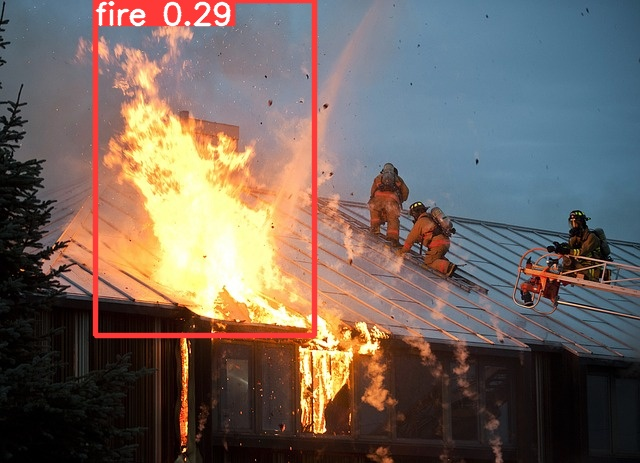

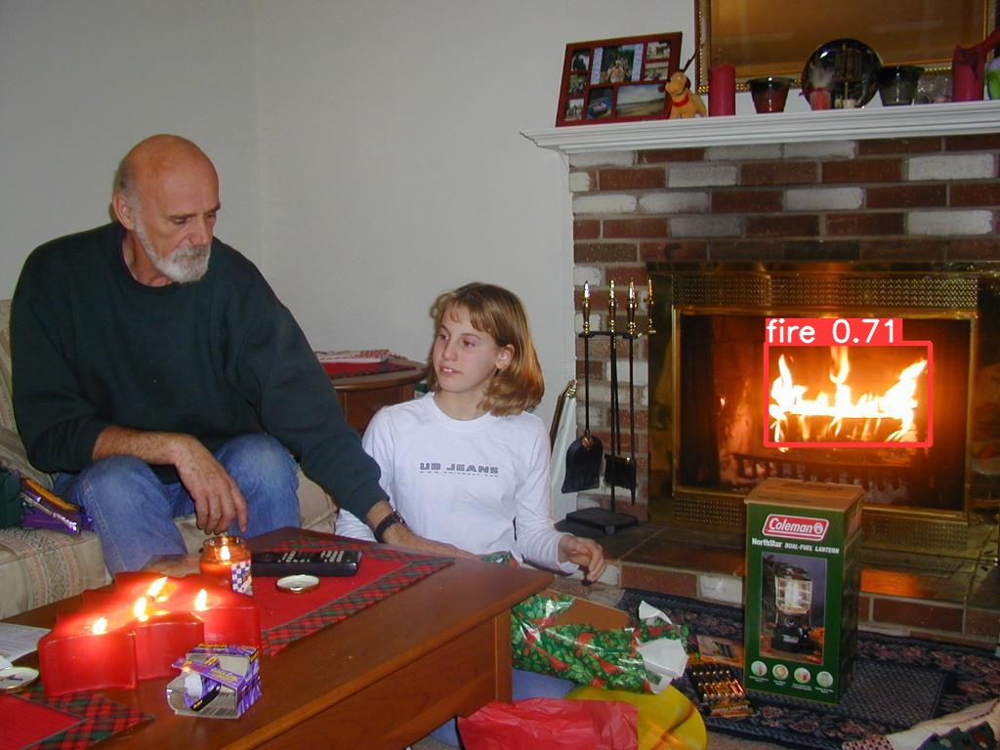

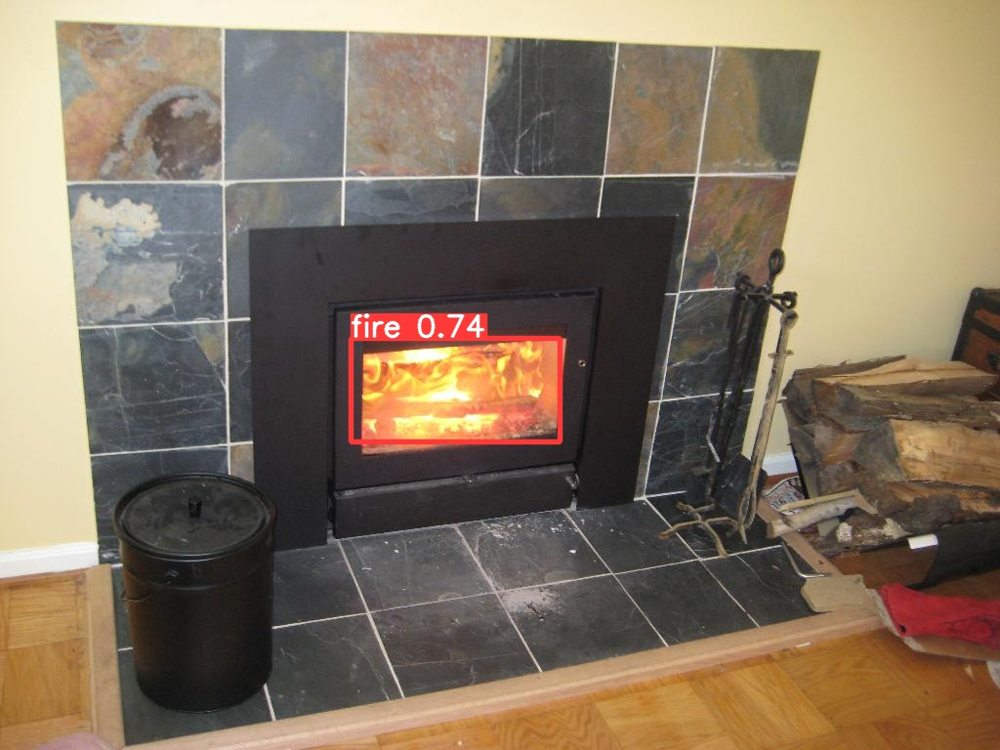

In [4]:
#display sample of test image
images = glob.glob('runs/detect/exp/*.jpg')

for imageName in images[:3]:
    display(Image(filename=imageName, width=400))

### Prediction on Video 

In [7]:
!python detect.py --weights ../models/best.pt --conf 0.25 --source ../flame1.avi

detect: weights=['../models/best.pt'], source=../flame1.avi, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-212-g9974d51 Python-3.10.5 torch-2.0.1+cpu CPU

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients
video 1/1 (1/402) C:\Users\sujal\Downloads\MajorProjectWork\WorkingPrototype\FireDetection\flame1.avi: 480x640 2 fires, 316.6ms
video 1/1 (2/402) C:\Users\sujal\Downloads\MajorProjectWork\WorkingPrototype\FireDetection\flame1.avi: 480x640 2 fires, 300.7ms
video 1/1 (3/402) C:\Users\sujal\Downloads\MajorProjectWork\WorkingPrototype\FireDetection\flame1.avi: 480x640 2 fires, 295.9ms
video 1/1 (4/402) C:\U

In [11]:
import cv2
vidcap = cv2.VideoCapture('../yolov5/runs/detect/exp4/flame1.mp4')
success,image = vidcap.read()
images = []
while success:
    success,image = vidcap.read()
    if success:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        images.append(image)

Animation size has reached 21267055 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


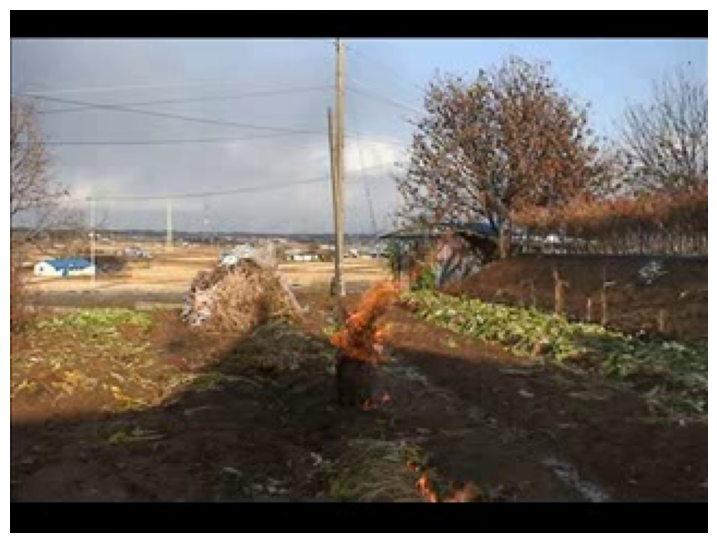

In [12]:
#Stitch sample images to form video 
from matplotlib import animation, rc
import matplotlib.pyplot as plt

rc('animation', html='jshtml')

def create_animation(ims):
    fig = plt.figure(figsize=(9, 9))
    plt.axis('off')
    im = plt.imshow(ims[0])

    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames = len(ims), interval = 1000//12)

create_animation(images)

# Visualize feature map

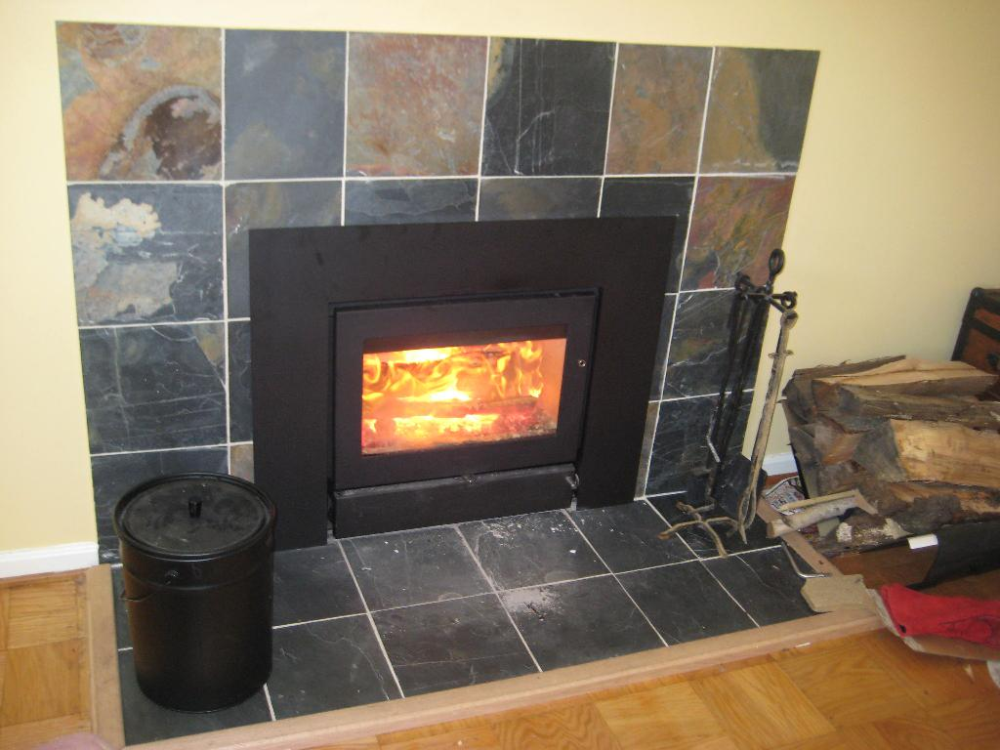

In [13]:
image_path = "../datasets/fire/val/images/004dec94c5de631f.jpg"
display(Image(filename=image_path, width=400))

In [14]:
!python detect.py --weights ../models/best.pt --conf 0.25 --source {image_path} --visualize

detect: weights=['../models/best.pt'], source=../datasets/fire/val/images/004dec94c5de631f.jpg, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=True, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-212-g9974d51 Python-3.10.5 torch-2.0.1+cpu CPU

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients
Saving runs\detect\exp2\004dec94c5de631f\stage0_Conv_features.png... (32/32)
Saving runs\detect\exp2\004dec94c5de631f\stage1_Conv_features.png... (32/64)
Saving runs\detect\exp2\004dec94c5de631f\stage2_C3_features.png... (32/64)
Saving runs\detect\exp2\004dec94c5de631f\stage3_Conv_features.png... (32/128)
Saving runs\detect\exp2\004dec94c5de631f\stage4_C3_features.png..

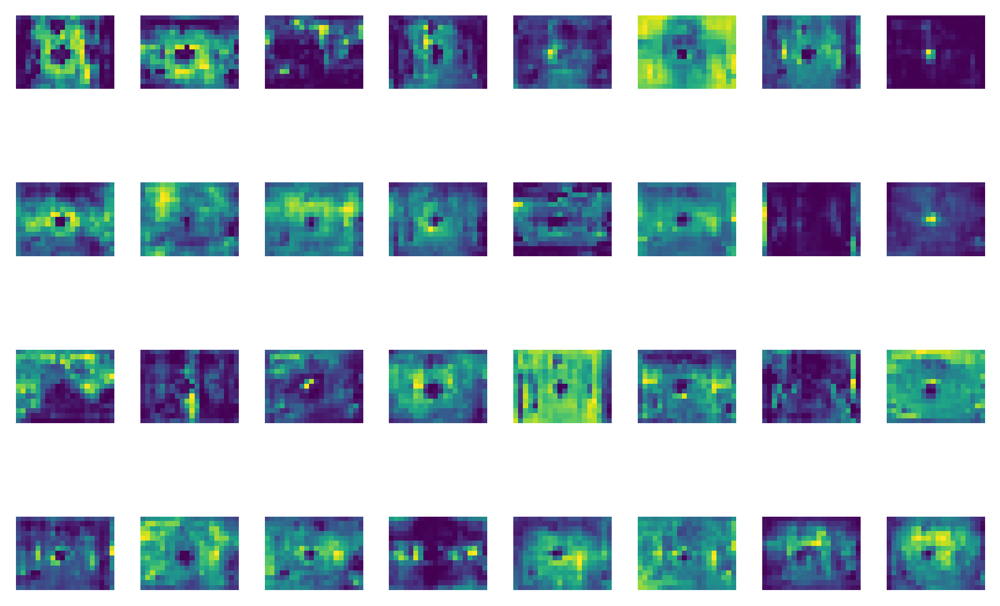

In [15]:
display(Image(filename="runs/detect/exp6/004dec94c5de631f/stage23_C3_features.png"))